# Monet Painting Mini Project
The objective of this project is to develop a Generative Adversarial Network (GAN) that can generate between 7,000 and 10,000 images styled after the work of Claude Monet. The challenge lies in translating everyday landscape photographs into impressionist paintings that convincingly capture Monet’s unique visual style, characterized by expressive brushstrokes, vibrant color palettes, and subtle lighting. While computer vision has made remarkable strides in recent years, particularly in the realm of image generation through GANs, the task of creating fine art remains a compelling frontier. The core question this project seeks to answer is whether data science, specifically GAN-based models, can convincingly imitate a true Monet to the point of deceiving trained classifiers. To tackle this challenge, we use a CycleGAN architecture, which involves two neural networks: a generator and a discriminator. The generator is trained to transform real-world photos into Monet-style paintings, while the discriminator evaluates whether the generated images are indistinguishable from authentic Monet artworks. These two models are trained in opposition, with the generator continuously refining its output to deceive the discriminator, and the discriminator simultaneously improving its ability to detect fakes.

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
import matplotlib.pyplot as plt
import math
from tensorflow import keras
from tensorflow.keras import layers
from PIL import Image

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
import glob
# for dirname, _, filenames in os.walk('/kaggle/input'):
#    for filename in filenames:
#        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Exploratory Data Analysis
Exploratory Data Analysis (EDA) is a critical first step in understanding the composition, quality, and structure of the data that will drive this project. Since the goal is to translate photographs into Monet-style paintings, it is important to closely examine the datasets representing both domains: real-world landscape photos and authentic Monet artworks. The primary aim of this stage is to build familiarity with the data and ensure it is suitable for training a CycleGAN model. This involves navigating through the file structure, inspecting image resolutions and formats, and checking for any corrupt or missing files. Visual inspection plays an important role here, as viewing random samples from each domain can help identify stylistic characteristics such as color schemes, textures, brush strokes, and contrasts.

## Data Loading
Let’s start by reading the training data provided in the form of TFRecord files. These files contain images from two distinct domains: real-world landscape photographs and Monet-style paintings. Since the number of Monet-style images is significantly smaller (around 300) compared to the number of photo images (over 7,000), we know upfront that this is an unpaired dataset — that is, there is no one-to-one correspondence between Monet paintings and their photo counterparts. We’ll use tf.data.TFRecordDataset to load each domain separately. Then, we’ll combine them into a ZipDataset, which allows us to iterate over photo and Monet images in parallel, even though the pairing is artificial. This is perfectly acceptable for training a CycleGAN, which doesn’t require paired data. We also define a parser function to decode and normalize each image. All images will be resized to 256x256 pixels and normalized to a range between -1 and 1, which is standard practice for GAN training.

In [4]:
IMG = 256
AUTOTUNE = tf.data.AUTOTUNE

# Files
monet_files = tf.io.gfile.glob("/kaggle/input/gan-getting-started/monet_tfrec/*.tfrec")
photo_files = tf.io.gfile.glob("/kaggle/input/gan-getting-started/photo_tfrec/*.tfrec")

# Parse
def parse_example(ex):
    feat = {"image": tf.io.FixedLenFeature([], tf.string)}
    ex = tf.io.parse_single_example(ex, feat)
    img = tf.image.decode_jpeg(ex["image"], channels=3)   # bytes -> uint8 [0..255]
    return img

# Resize
def resize(img):
    return tf.image.resize(img, [IMG, IMG], method=tf.image.ResizeMethod.BICUBIC)

# Your robust normalize (good!)
def robust_normalize(img):
    img = tf.cast(img, tf.float32)
    mn = tf.reduce_min(img); mx = tf.reduce_max(img)
    def case_neg1_1(): return img
    def case_0_1():    return img*2.0 - 1.0
    def case_0_255():  return (img/127.5) - 1.0
    return tf.case([
        (tf.logical_and(mn >= -1.01, mx <= 1.01), case_neg1_1),
        (tf.logical_and(mn >= -0.01, mx <= 1.01), case_0_1),
    ], default=case_0_255)

# Build datasets (NO other normalization anywhere else)
monet_ds = (tf.data.TFRecordDataset(monet_files, num_parallel_reads=AUTOTUNE)
            .map(parse_example, num_parallel_calls=AUTOTUNE)
            .map(resize,         num_parallel_calls=AUTOTUNE)
            .map(robust_normalize, num_parallel_calls=AUTOTUNE)
            .batch(8).prefetch(AUTOTUNE))

photo_ds = (tf.data.TFRecordDataset(photo_files, num_parallel_reads=AUTOTUNE)
            .map(parse_example, num_parallel_calls=AUTOTUNE)
            .map(resize,         num_parallel_calls=AUTOTUNE)
            .map(robust_normalize, num_parallel_calls=AUTOTUNE)
            .batch(8).prefetch(AUTOTUNE))



## Data Exploration
With the data now loaded into TensorFlow Dataset objects, we can begin exploring it visually. Since CycleGAN operates on two distinct image domains, it's important to understand the stylistic differences between them early in the process.
Here, we take a sample batch from both the Monet paintings and the real landscape photos. Visualizing them side by side helps us observe key characteristics that distinguish each domain — such as Monet’s vivid color choices, loose brushwork, and abstraction, compared to the sharper, more realistic photo representations.
This exploration is not only useful for gaining intuition about what the model must learn, but it also helps confirm that the data has been preprocessed correctly — particularly in terms of image shape and range.

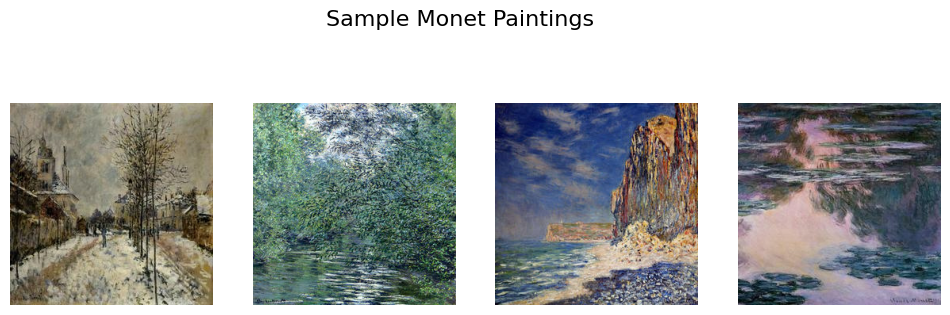

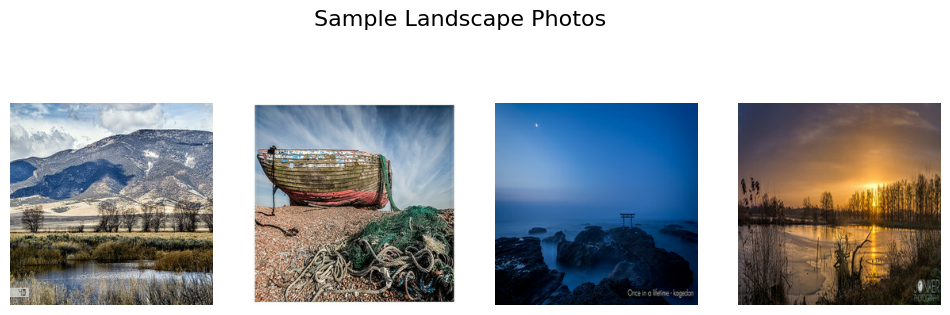

In [5]:
# Function to denormalize images from [-1, 1] to [0, 1]
def denormalize(image):
    return (image + 1) / 2

# Get one batch from each domain
monet_sample_batch = next(iter(monet_ds))
photo_sample_batch = next(iter(photo_ds))

# Visualize samples
def show_images(images, title):
    plt.figure(figsize=(12, 4))
    plt.suptitle(title, fontsize=16)
    for i in range(4):
        plt.subplot(1, 4, i + 1)
        plt.imshow(denormalize(images[i]).numpy())
        plt.axis('off')
    plt.show()

show_images(monet_sample_batch, "Sample Monet Paintings")
show_images(photo_sample_batch, "Sample Landscape Photos")


## Pre Processing

What
Pre-processing prepares the raw images so they can be safely and effectively used by the CycleGAN. Each image in the dataset begins as a JPEG with pixel values in the range [0,255][0, 255][0,255]. For consistency across the model, we resize every image to a fixed dimension of 256×256256 times 256256×256 pixels and then normalize the pixel values to fall within [−1,1][-1, 1][−1,1].

Why
Normalization is essential for training stability. GANs, in particular, are sensitive to the scale of the input values: if left in the range [0,255][0, 255][0,255], the gradients during backpropagation can become excessively large, slowing or destabilizing training. Confining the values to [−1,1][-1, 1][−1,1] helps the optimizer converge more quickly and makes the activation functions operate in their most effective regions. Resizing is also necessary because training requires uniform input dimensions. Without resizing, inconsistent image shapes would make batching impossible.

How
The process involves first decoding the TFRecords into raw images. Each image is then resized to 256×256256 \times 256256×256 using bicubic interpolation. After resizing, the pixel values are cast to float32 and rescaled by dividing by 127.5 and subtracting 1.0. This simple transformation shifts the pixel range from [0,255][0, 255][0,255] into [−1,1][-1, 1][−1,1]. No additional augmentation techniques such as flipping or color jitter are applied here, since we want the model to focus solely on learning the style transfer rather than invariances to geometric or photometric transformations.
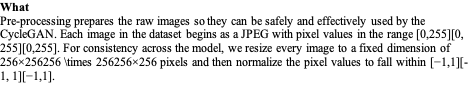
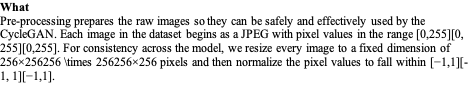
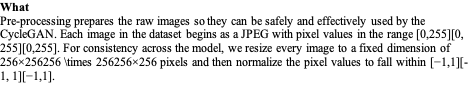
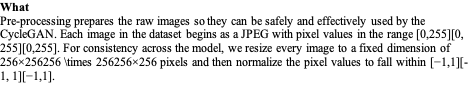
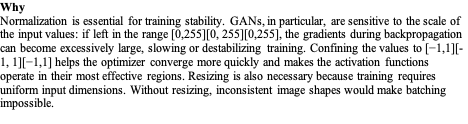
...
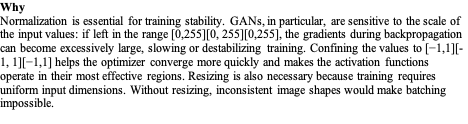
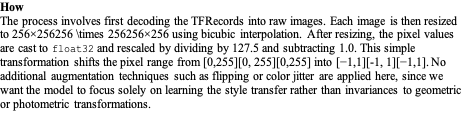
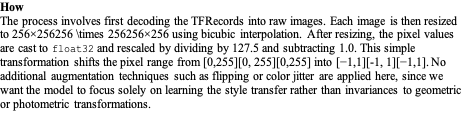
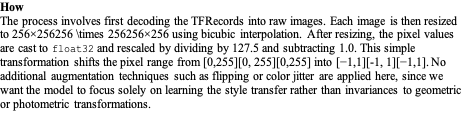
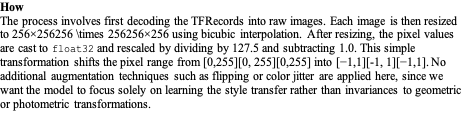

monet batch: shape=(8, 256, 256, 3), dtype=<dtype: 'float32'>, min=-1.0000, max=1.0000


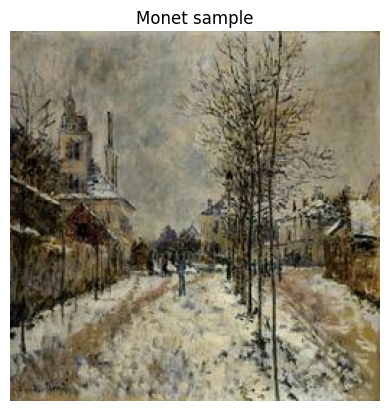

photo batch: shape=(8, 256, 256, 3), dtype=<dtype: 'float32'>, min=-1.0000, max=1.0000


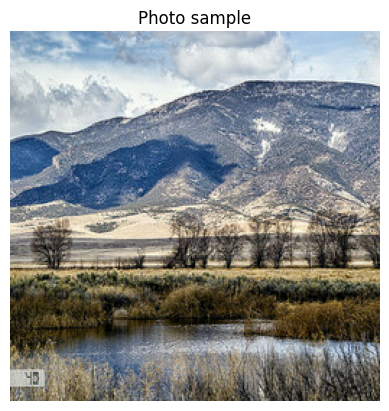

In [6]:
def stats(name, x):
    print(f"{name}: shape={x.shape}, dtype={x.dtype}, "
          f"min={tf.reduce_min(x).numpy():.4f}, max={tf.reduce_max(x).numpy():.4f}")

def show(img, title):
    # images are in [-1,1]; map to [0,1] for display
    img01 = tf.clip_by_value((tf.cast(img, tf.float32)+1.0)/2.0, 0.0, 1.0)
    plt.imshow(img01.numpy()); plt.title(title); plt.axis("off"); plt.show()

mb = next(iter(monet_ds))
pb = next(iter(photo_ds))

stats("monet batch", mb);  show(mb[0], "Monet sample")
stats("photo batch", pb);  show(pb[0], "Photo sample")

## Analysis
What
The analysis step is about evaluating the readiness of our datasets and understanding the relationship between the two domains — Monet paintings and real photos. It goes beyond simply looking at images and instead tries to measure the differences in structure, color distributions, and feature spaces between the domains.
Why
This is important because CycleGAN must learn to map between two very different styles without paired examples. If the two domains are extremely dissimilar in terms of color palettes, textures, or structural content, the training process could become unstable or the generator might fail to preserve semantic content when transferring style. By performing analysis, we set expectations about how challenging the translation task will be and can adjust the model design, training schedule, or loss functions accordingly.
How
We can begin by computing simple statistical comparisons such as average color histograms or pixel intensity distributions, which reveal biases in each dataset. To gain deeper insights, we can project image features into lower-dimensional spaces using methods like PCA or t-SNE, helping us visualize the separation between the two domains. Another way is to run a pretrained network, such as Inception or VGG, on both domains and compare activations, which highlights higher-level feature differences. Through this analysis, we verify that the two datasets are distinct enough to warrant style transfer and that the preprocessing has not inadvertently destroyed domain-specific characteristics.



# Model Architecture
What
The task here is to translate photographs into Monet-style paintings without paired training data. To achieve this, we use a CycleGAN architecture, which is composed of two generators and two discriminators. One generator learns to map photos into the Monet domain, while the other maps Monet paintings back into the photo domain. Each domain also has a discriminator, which learns to distinguish real images from generated ones.
Why
Since paired data is difficult or even impossible to obtain in most domains, supervised approaches like pix2pix are not feasible here. CycleGAN provides a solution through unpaired image-to-image translation, which is perfectly suited to our dataset of ~300 Monet paintings and ~7,000 landscape photographs. The model enforces cycle consistency: if a photo is translated into Monet style and then translated back, it should resemble the original photo. This encourages the generators to preserve content while changing style, leading to realistic and coherent outputs.
How
The CycleGAN framework is trained adversarially: the generators aim to produce convincing images that fool the discriminators, while the discriminators try to correctly distinguish between real and generated samples. In addition to adversarial loss, cycle consistency loss ensures that a round-trip translation (photo → Monet → photo) preserves the original image. Identity loss further stabilizes training by encouraging generators to leave images unchanged if they are already in the target domain. With this setup, we can train on the provided datasets to learn robust style transfer, and once trained, use the photo-to-Monet generator to produce Monet-style images from new photographs.


In [7]:
# ----------------------------
# Utility layers
# ----------------------------
class ReflectionPadding2D(layers.Layer):
    def __init__(self, padding=(1, 1), **kwargs):
        super().__init__(**kwargs)
        if isinstance(padding, int):
            padding = (padding, padding)
        self.padding = padding

    def call(self, x):
        p_h, p_w = self.padding
        return tf.pad(x, [[0,0],[p_h,p_h],[p_w,p_w],[0,0]], mode="REFLECT")

    def get_config(self):
        cfg = super().get_config()
        cfg.update({"padding": self.padding})
        return cfg

class InstanceNorm(layers.Layer):
    def __init__(self, epsilon=1e-5, **kwargs):
        super().__init__(**kwargs)
        self.epsilon = epsilon

    def build(self, input_shape):
        channels = input_shape[-1]
        self.gamma = self.add_weight(name="gamma", shape=(channels,),
                                     initializer="ones", trainable=True)
        self.beta  = self.add_weight(name="beta",  shape=(channels,),
                                     initializer="zeros", trainable=True)

    def call(self, x):
        mean, var = tf.nn.moments(x, axes=[1,2], keepdims=True)
        x_hat = (x - mean) / tf.sqrt(var + self.epsilon)
        return self.gamma * x_hat + self.beta

    def get_config(self):
        cfg = super().get_config()
        cfg.update({"epsilon": self.epsilon})
        return cfg

# ----------------------------
# Residual block for Generator
# ----------------------------
def res_block(x, filters):
    y = ReflectionPadding2D(1)(x)
    y = layers.Conv2D(filters, 3, padding="valid", use_bias=False)(y)
    y = InstanceNorm()(y)
    y = layers.ReLU()(y)

    y = ReflectionPadding2D(1)(y)
    y = layers.Conv2D(filters, 3, padding="valid", use_bias=False)(y)
    y = InstanceNorm()(y)
    return layers.Add()([x, y])

# ----------------------------
# ResNet Generator (256×256)
# ----------------------------
def build_generator(img_channels=3, n_res_blocks=9, base_filters=64):
    inputs = keras.Input(shape=(256, 256, img_channels))

    x = ReflectionPadding2D(3)(inputs)
    x = layers.Conv2D(base_filters, 7, padding="valid", use_bias=False)(x)
    x = InstanceNorm()(x)
    x = layers.ReLU()(x)

    # Downsample (×2, ×4)
    f = base_filters
    for _ in range(2):
        f *= 2
        x = layers.Conv2D(f, 3, strides=2, padding="same", use_bias=False)(x)
        x = InstanceNorm()(x)
        x = layers.ReLU()(x)

    # Residual trunk
    for _ in range(n_res_blocks):
        x = res_block(x, f)

    # Upsample (÷2, ÷4)
    for _ in range(2):
        f //= 2
        x = layers.Conv2DTranspose(f, 3, strides=2, padding="same", use_bias=False)(x)
        x = InstanceNorm()(x)
        x = layers.ReLU()(x)

    x = ReflectionPadding2D(3)(x)
    x = layers.Conv2D(img_channels, 7, padding="valid")(x)
    outputs = layers.Activation("tanh")(x)  # outputs in [-1, 1]

    return keras.Model(inputs, outputs, name="Generator")

# ----------------------------
# 70×70 PatchGAN Discriminator
# ----------------------------
def conv_block(x, filters, stride):
    x = layers.Conv2D(filters, 4, strides=stride, padding="same")(x)
    x = layers.LeakyReLU(0.2)(x)
    return x

def norm_conv_block(x, filters, stride):
    x = layers.Conv2D(filters, 4, strides=stride, padding="same", use_bias=False)(x)
    x = InstanceNorm()(x)
    x = layers.LeakyReLU(0.2)(x)
    return x

def build_discriminator(img_channels=3, base_filters=64):
    inputs = keras.Input(shape=(256, 256, img_channels))
    x = conv_block(inputs, base_filters, 2)            # 128×128
    x = norm_conv_block(x, base_filters*2, 2)          # 64×64
    x = norm_conv_block(x, base_filters*4, 2)          # 32×32
    x = norm_conv_block(x, base_filters*8, 1)          # 32×32 (receptive field ~70)
    x = layers.Conv2D(1, 4, padding="same")(x)         # Patch logits
    return keras.Model(inputs, x, name="Discriminator")

# ----------------------------
# Instantiate CycleGAN parts
# ----------------------------
G_P2M = build_generator()   # Photo → Monet
G_M2P = build_generator()   # Monet → Photo
D_M   = build_discriminator()  # Real/Fake in Monet domain
D_P   = build_discriminator()  # Real/Fake in Photo domain

G_P2M.summary()
G_M2P.summary()
D_M.summary()
D_P.summary()

Model: "Generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 262, 262,  │          0 │ input_layer[0][0] │
│ (ReflectionPadding… │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │      9,408 │ reflection_paddi… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm       │ (None, 256, 256,  │        128 │ conv2d[0][0]      │
│ (InstanceNorm)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 256, 256,  │          0 │ instance_norm[0]… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │     73,728 │ re_lu[0][0]       │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_1     │ (None, 128, 128,  │        256 │ conv2d_1[0][0]    │
│ (InstanceNorm)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 128, 128,  │          0 │ instance_norm_1[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │    294,912 │ re_lu_1[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_2     │ (None, 64, 64,    │        512 │ conv2d_2[0][0]    │
│ (InstanceNorm)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_2 (ReLU)      │ (None, 64, 64,    │          0 │ instance_norm_2[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 66, 66,    │          0 │ re_lu_2[0][0]     │
│ (ReflectionPadding… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │    589,824 │ reflection_paddi… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_3     │ (None, 64, 64,    │        512 │ conv2d_3[0][0]    │
│ (InstanceNorm)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_3 (ReLU)      │ (None, 64, 64,    │          0 │ instance_norm_3[… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 66, 66,    │          0 │ re_lu_3[0][0]     │
│ (ReflectionPadding… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    589,824 │ reflection_paddi

 Total params: 11,383,427 (43.42 MB)

 Trainable params: 11,383,427 (43.42 MB)

 Non-trainable params: 0 (0.00 B)

Model: "Generator"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer_1       │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 262, 262,  │          0 │ input_layer_1[0]… │
│ (ReflectionPadding… │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_22 (Conv2D)  │ (None, 256, 256,  │      9,408 │ reflection_paddi… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_23    │ (None, 256, 256,  │        128 │ conv2d_22[0][0]   │
│ (InstanceNorm)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_14 (ReLU)     │ (None, 256, 256,  │          0 │ instance_norm_23… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_23 (Conv2D)  │ (None, 128, 128,  │     73,728 │ re_lu_14[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_24    │ (None, 128, 128,  │        256 │ conv2d_23[0][0]   │
│ (InstanceNorm)      │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_15 (ReLU)     │ (None, 128, 128,  │          0 │ instance_norm_24… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_24 (Conv2D)  │ (None, 64, 64,    │    294,912 │ re_lu_15[0][0]    │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_25    │ (None, 64, 64,    │        512 │ conv2d_24[0][0]   │
│ (InstanceNorm)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_16 (ReLU)     │ (None, 64, 64,    │          0 │ instance_norm_25… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 66, 66,    │          0 │ re_lu_16[0][0]    │
│ (ReflectionPadding… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_25 (Conv2D)  │ (None, 64, 64,    │    589,824 │ reflection_paddi… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ instance_norm_26    │ (None, 64, 64,    │        512 │ conv2d_25[0][0]   │
│ (InstanceNorm)      │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_17 (ReLU)     │ (None, 64, 64,    │          0 │ instance_norm_26… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ reflection_padding… │ (None, 66, 66,    │          0 │ re_lu_17[0][0]    │
│ (ReflectionPadding… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_26 (Conv2D)  │ (None, 64, 64,    │    589,824 │ reflection_paddi

 Total params: 11,383,427 (43.42 MB)

 Trainable params: 11,383,427 (43.42 MB)

 Non-trainable params: 0 (0.00 B)

Model: "Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 128, 128, 64)   │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 64, 64, 128)    │       131,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_46 (InstanceNorm) │ (None, 64, 64, 128)    │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 32, 32, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_47 (InstanceNorm) │ (None, 32, 32, 256)    │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 32, 32, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_48 (InstanceNorm) │ (None, 32, 32, 512)    │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_48 (Conv2D)              │ (None, 32, 32, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,765,633 (10.55 MB)

 Trainable params: 2,765,633 (10.55 MB)

 Non-trainable params: 0 (0.00 B)

Model: "Discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_3 (InputLayer)      │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_49 (Conv2D)              │ (None, 128, 128, 64)   │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_50 (Conv2D)              │ (None, 64, 64, 128)    │       131,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_49 (InstanceNorm) │ (None, 64, 64, 128)    │           256 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_51 (Conv2D)              │ (None, 32, 32, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_50 (InstanceNorm) │ (None, 32, 32, 256)    │           512 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_52 (Conv2D)              │ (None, 32, 32, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ instance_norm_51 (InstanceNorm) │ (None, 32, 32, 512)    │         1,024 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 32, 32, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_53 (Conv2D)              │ (None, 32, 32, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,765,633 (10.55 MB)

 Trainable params: 2,765,633 (10.55 MB)

 Non-trainable params: 0 (0.00 B)

# Visualize
What
We want a quick visual check that generators produce sensible outputs on preprocessed batches: photos should become Monet-like; Monet paintings run through the inverse generator should reconstruct photo-like content.
Why
Early qualitative feedback catches normalization mistakes, channel ordering issues, or model wiring bugs before long training runs.
How
Take a small batch from each domain, run it through the appropriate generator, and plot a compact grid. Convert values from [−1,1][-1,1][−1,1] back to [0,1][0,1][0,1] 
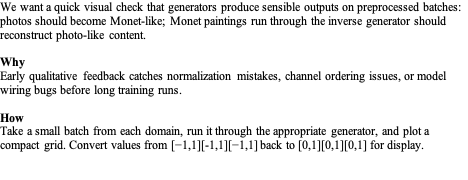
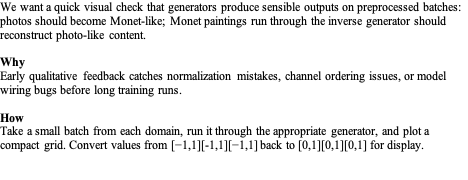
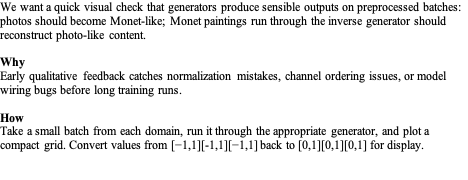
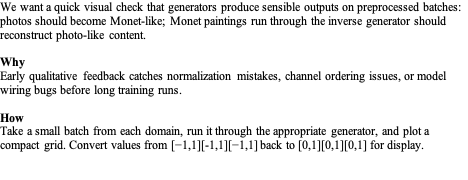

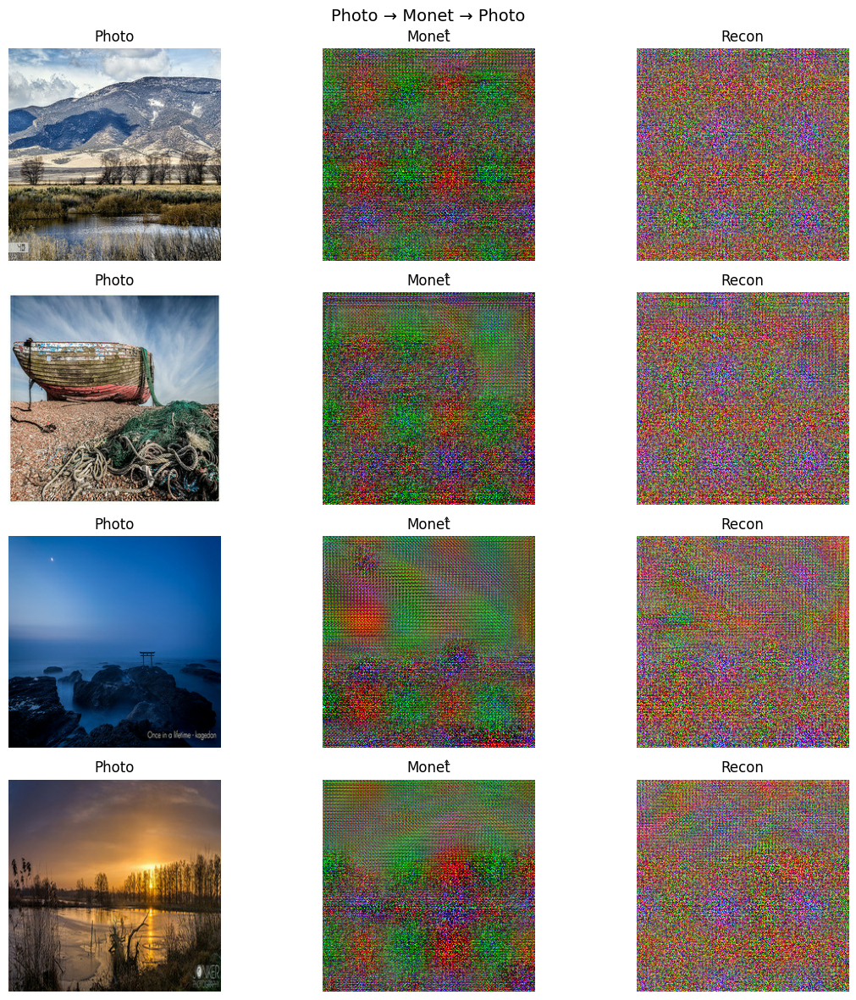

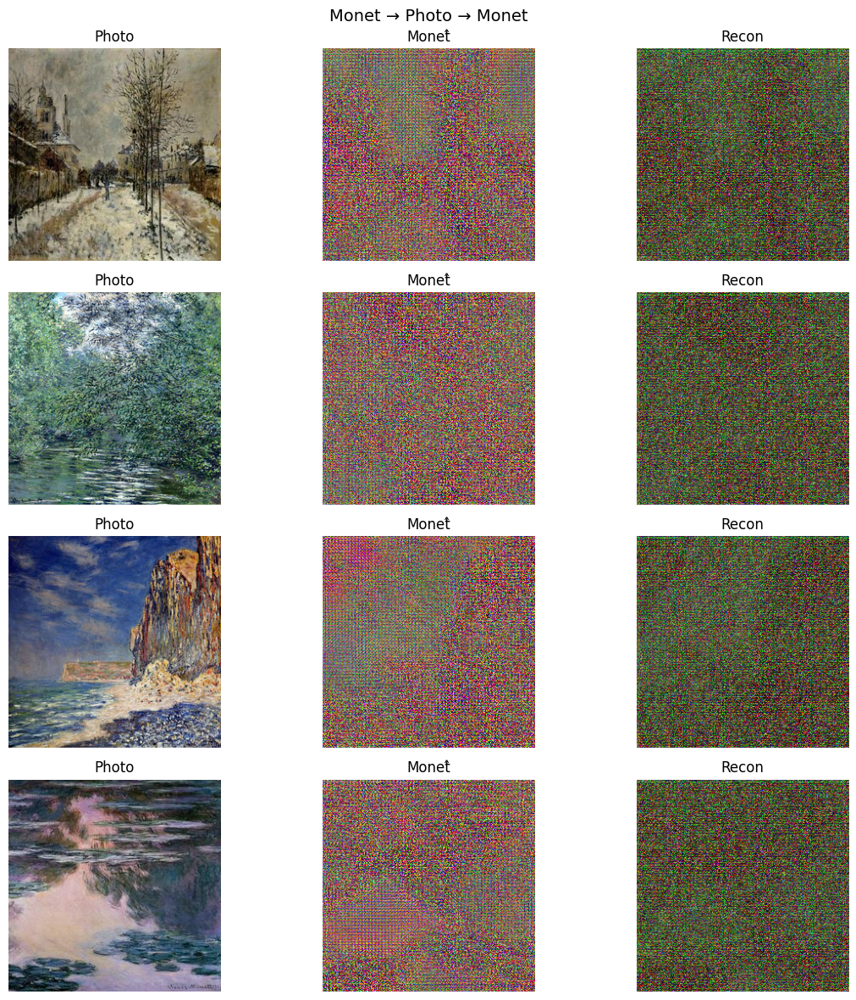

In [8]:
def to01(x):
    # robust map to [0,1] assuming generator outputs tanh
    return tf.clip_by_value((x + 1.0) / 2.0, 0.0, 1.0)

def show_triplet_grid(photos, fake_monets, recon_photos, n=4, title="Photo → Monet → Photo"):
    n = min(n, photos.shape[0])
    cols, rows = 3, n
    plt.figure(figsize=(4*cols, 3*rows))
    plt.suptitle(title, fontsize=14)
    for i in range(n):
        plt.subplot(rows, cols, i*cols + 1); plt.imshow(to01(photos[i]).numpy()); plt.axis("off"); plt.title("Photo")
        plt.subplot(rows, cols, i*cols + 2); plt.imshow(to01(fake_monets[i]).numpy()); plt.axis("off"); plt.title("Monet̂")
        plt.subplot(rows, cols, i*cols + 3); plt.imshow(to01(recon_photos[i]).numpy()); plt.axis("off"); plt.title("Recon")
    plt.tight_layout(); plt.show()

photo_batch = next(iter(photo_ds))
monet_batch = next(iter(monet_ds))


fake_monet = G_P2M(photo_batch, training=False)
recon_photo = G_M2P(fake_monet, training=False)

fake_photo = G_M2P(monet_batch, training=False)
recon_monet = G_P2M(fake_photo, training=False)

show_triplet_grid(photo_batch, fake_monet, recon_photo, n=4, title="Photo → Monet → Photo")
show_triplet_grid(monet_batch, fake_photo, recon_monet, n=4, title="Monet → Photo → Monet")

In [10]:
def to01(x):
    x = tf.cast(x, tf.float32)
    mn = tf.reduce_min(x); mx = tf.reduce_max(x)
    # If already [-1,1] -> [0,1]
    if mx <= 1.01 and mn >= -1.01:
        x = (x + 1.0) / 2.0
    # Else if 0..1 keep; else assume 0..255
    elif not (mx <= 1.01 and mn >= 0.0):
        x = x / 255.0
    return tf.clip_by_value(x, 0.0, 1.0)

# Basic GAN panel (noise → Monet-like images)

What
This code defines and tests a minimal DCGAN style generator that turns a latent noise vector of size 128 into a 256 by 256 by 3 RGB image with pixel values in the range minus one to one. The build_noise_generator function creates the generator as a small upsampling network using dense, reshape, and a series of transposed convolutions. The show_basic_gan_samples function draws random latent codes, runs them through the generator, and displays the resulting images in a grid. The smoke test at the end simply verifies that the model produces images of the right shape and that the plotting pipeline works. Outputs will look like noise before training.
Why
A basic noise to image generator is useful for two reasons in this project. First, it provides a baseline unconditional Monet like image sampler that can be trained only on Monet paintings, complementing the translation capability of CycleGAN. Second, it is a quick way to confirm the input and output scaling and the visualization logic. If untrained outputs render correctly, then any black or gray box issues are likely due to preprocessing or plotting rather than model wiring. Using the tanh activation keeps outputs in the range minus one to one, which matches the normalization used throughout the notebook and makes denormalization for display straightforward.
How
The generator starts from a dense layer that projects the latent code into a 16 by 16 by eight times base tensor, reshaping noise into a low resolution feature map. It then upsamples in three stages with Conv2DTranspose layers where stride two doubles the spatial size each time. After each upsampling it applies BatchNormalization and ReLU to stabilize training and encourage healthy gradient flow. A final transposed convolution expands to three channels, and the tanh activation bounds the output to the range minus one to one. The visualization function samples a number of latent vectors from a standard normal distribution, runs a forward pass with training set to false, ensures the tensor is in channels last format if needed, maps values to the range zero to one for display, and plots an image grid. Running the smoke test confirms that shapes and ranges are correct. Seeing colorful noise is expected until the generator is trained.


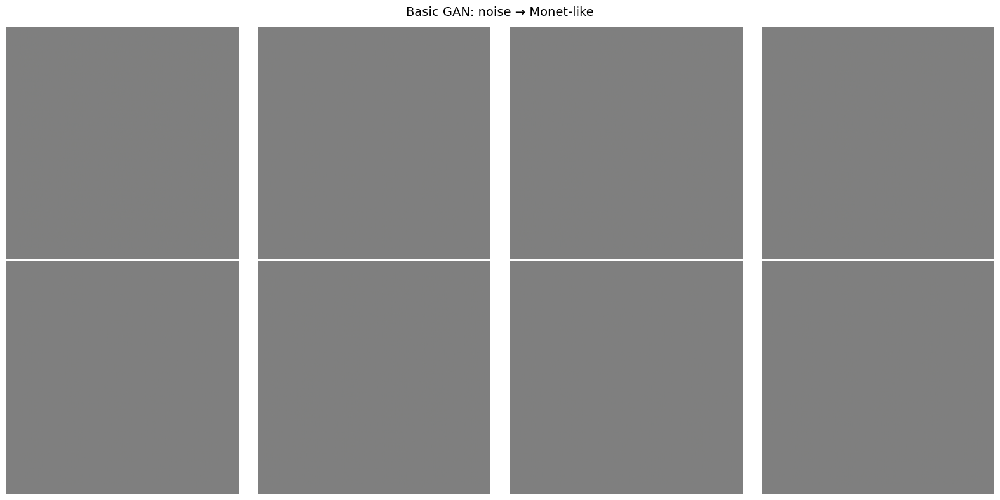

In [11]:
# --- Minimal DCGAN-style generator: z -> 256x256x3 (tanh) ---
def build_noise_generator(z_dim=128, base=64):
    z = keras.Input(shape=(z_dim,))
    x = layers.Dense(16*16*base*8, use_bias=False)(z)
    x = layers.Reshape((16, 16, base*8))(x)
    for f in [base*4, base*2, base]:
        x = layers.Conv2DTranspose(f, 4, strides=2, padding="same", use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.ReLU()(x)
    x = layers.Conv2DTranspose(3, 4, strides=2, padding="same")(x)  # 256x256x3
    out = layers.Activation("tanh")(x)  # [-1,1]
    return keras.Model(z, out, name="G_noise")

G_noise = build_noise_generator()

# --- Your visualization function (unchanged) ---
def show_basic_gan_samples(G_noise, z_dim=128, n=16, title="Basic GAN: noise → Monet-like"):
    z = tf.random.normal([n, z_dim])
    fakes = G_noise(z, training=False)

    # Ensure channels-last [B,H,W,3]
    if fakes.shape.rank == 4 and fakes.shape[-1] != 3 and fakes.shape[1] == 3:
        fakes = tf.transpose(fakes, [0, 2, 3, 1])

    cols = min(4, n)
    rows = math.ceil(n / cols)
    plt.figure(figsize=(4*cols, 4*rows))
    plt.suptitle(title, fontsize=14)
    for i in range(n):
        plt.subplot(rows, cols, i+1)
        plt.imshow(to01(fakes[i]).numpy())
        plt.axis("off")
    plt.tight_layout()
    plt.show()

# Smoke test (untrained = noisy images, but should DISPLAY)
show_basic_gan_samples(G_noise, z_dim=128, n=8)

# Build and train a simple DCGAN model on Monet paintings

What
The code defines all of the building blocks of a DCGAN system. First, it defines helper functions to normalize generated outputs into a range that can be displayed. Then it defines a generator model that upsamples a latent vector of random noise into a 256 by 256 by 3 image. It defines a discriminator model that classifies an image as real or fake. Loss functions are provided for both models based on binary cross entropy. Optimizers are set up for training. A training step function computes losses, gradients, and applies updates. A training loop function runs many steps and occasionally visualizes generated images. Finally, the code calls the training loop on the Monet dataset.

Why
The generator and discriminator must be trained together to create convincing Monet style images. The discriminator provides feedback to the generator about whether its outputs look real, and the generator learns to improve based on this feedback. Defining both models clearly and training them in an alternating fashion is the core of the GAN approach. Without this adversarial setup, the generator would not learn the characteristics of Monet paintings. The visualization function is included so that we can track progress and confirm that the generator is moving from random noise toward recognizable patterns.

How
The generator is built starting from a dense layer that maps a random noise vector into a low resolution feature map. This map is reshaped and then repeatedly upsampled with transposed convolutions, batch normalization, and ReLU activation functions until it reaches the size of 256 by 256 with three channels. The final activation is tanh so that outputs are in the range minus one to one.
The discriminator is built using standard convolutional layers with stride two to progressively downsample the input image. Each layer uses LeakyReLU and batch normalization to improve stability. The final layer outputs a single logit indicating whether the input is real or fake.
Loss functions are binary cross entropy based. The discriminator is trained to output ones for real images and zeros for generated images. The generator is trained to fool the discriminator into outputting ones for its generated images. Both optimizers are Adam with a learning rate of two times ten to the minus four and momentum parameters to stabilize training.
The training step samples noise, generates fake images, evaluates discriminator outputs on real and fake images, computes losses, calculates gradients with respect to model parameters, and applies updates. The training loop repeats this for a number of epochs and steps, and periodically calls the visualization function to show generated images.
Running the training loop on the Monet dataset will start with noisy images and gradually produce outputs that contain Monet like colors, textures, and patterns as the generator and discriminator improve through adversarial training.


Epoch 1/2 Step 25/400 | D: 0.595  G: 1.338
Epoch 1/2 Step 50/400 | D: 0.303  G: 2.267
Epoch 1/2 Step 75/400 | D: 0.360  G: 1.911
Epoch 1/2 Step 100/400 | D: 0.804  G: 0.934
Epoch 1/2 Step 125/400 | D: 0.717  G: 1.892
Epoch 1/2 Step 150/400 | D: 0.609  G: 1.140
Epoch 1/2 Step 175/400 | D: 1.093  G: 0.698
Epoch 1/2 Step 200/400 | D: 0.665  G: 1.387


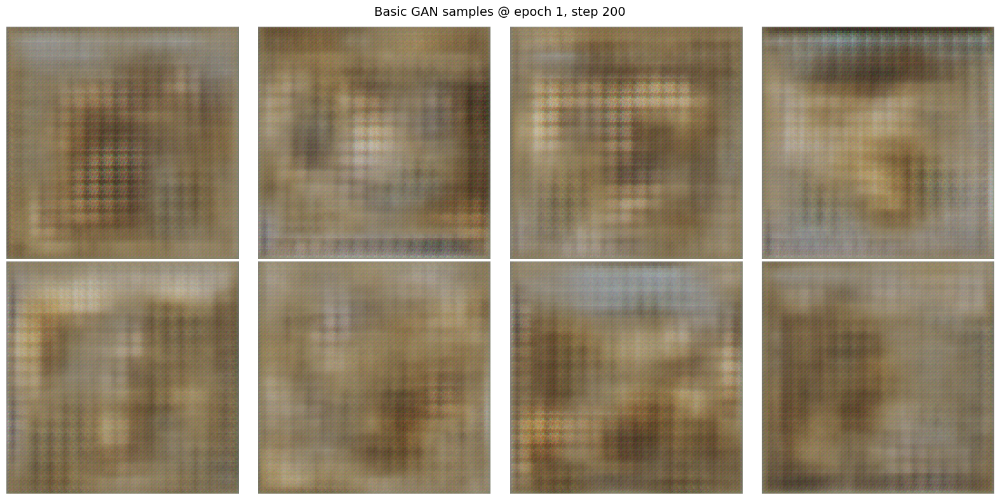

Epoch 1/2 Step 225/400 | D: 0.732  G: 1.293
Epoch 1/2 Step 275/400 | D: 0.637  G: 2.058
Epoch 1/2 Step 300/400 | D: 0.545  G: 1.316
Epoch 1/2 Step 325/400 | D: 0.539  G: 1.645
Epoch 1/2 Step 350/400 | D: 0.690  G: 1.188
Epoch 1/2 Step 375/400 | D: 0.492  G: 2.278
Epoch 1/2 Step 400/400 | D: 1.030  G: 1.046


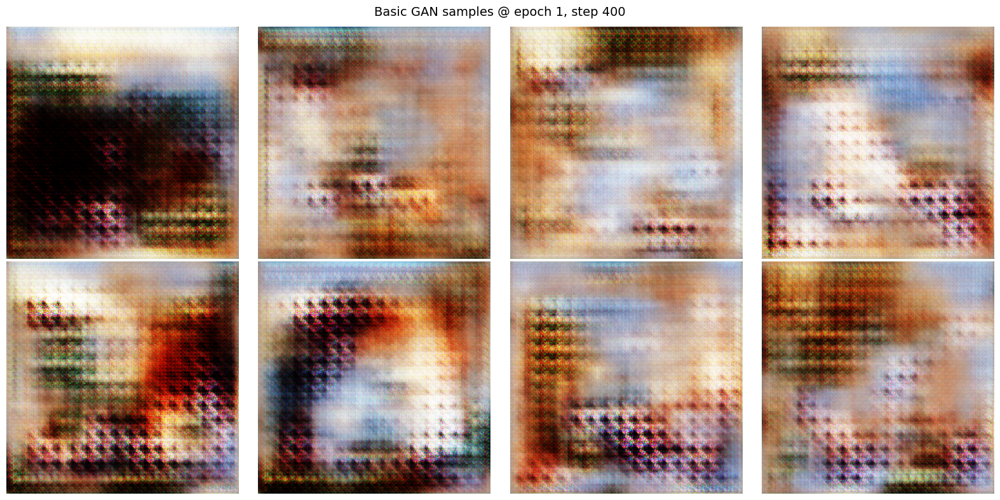

Epoch 2/2 Step 25/400 | D: 0.579  G: 2.043
Epoch 2/2 Step 50/400 | D: 0.984  G: 0.598
Epoch 2/2 Step 75/400 | D: 0.908  G: 0.722
Epoch 2/2 Step 100/400 | D: 0.876  G: 0.838
Epoch 2/2 Step 125/400 | D: 1.427  G: 4.409
Epoch 2/2 Step 150/400 | D: 0.621  G: 1.394
Epoch 2/2 Step 175/400 | D: 0.722  G: 1.187
Epoch 2/2 Step 200/400 | D: 0.563  G: 1.053


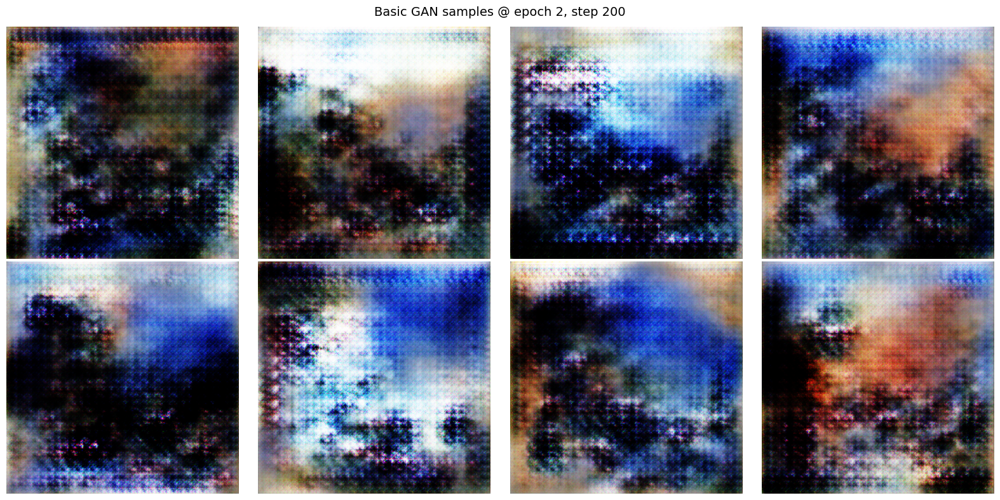

Epoch 2/2 Step 250/400 | D: 0.300  G: 2.951
Epoch 2/2 Step 275/400 | D: 0.512  G: 2.505
Epoch 2/2 Step 300/400 | D: 0.523  G: 1.380
Epoch 2/2 Step 325/400 | D: 0.805  G: 1.147
Epoch 2/2 Step 350/400 | D: 0.487  G: 2.047
Epoch 2/2 Step 375/400 | D: 0.546  G: 3.277
Epoch 2/2 Step 400/400 | D: 0.484  G: 1.683


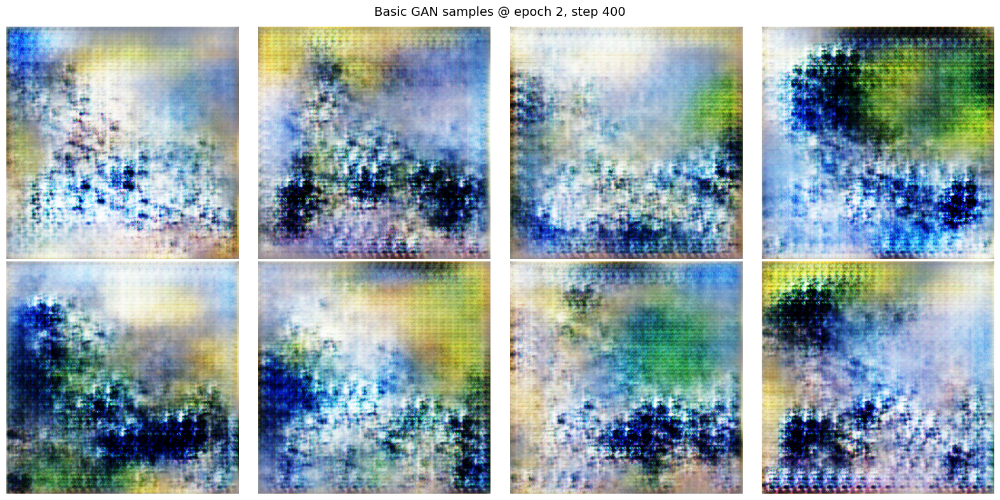

In [12]:
def to01(x):
    x = tf.cast(x, tf.float32)
    return tf.clip_by_value((x + 1.0) / 2.0, 0.0, 1.0)

def show_basic_gan_samples(G_noise, z_dim=128, n=12, title="Basic GAN: noise → Monet-like"):
    z = tf.random.normal([n, z_dim])
    fakes = G_noise(z, training=False)
    cols = min(4, n); rows = math.ceil(n/cols)
    plt.figure(figsize=(4*cols, 4*rows))
    plt.suptitle(title, fontsize=14)
    for i in range(n):
        plt.subplot(rows, cols, i+1)
        plt.imshow(to01(fakes[i]).numpy()); plt.axis("off")
    plt.tight_layout(); plt.show()

# -----------------------------
# Generator: z -> 256x256x3 (tanh)
# -----------------------------
def build_noise_generator(z_dim=128, base=64):
    z = keras.Input(shape=(z_dim,))
    x = layers.Dense(16*16*base*8, use_bias=False)(z)
    x = layers.Reshape((16, 16, base*8))(x)
    for f in [base*4, base*2, base]:
        x = layers.Conv2DTranspose(f, 4, strides=2, padding="same", use_bias=False)(x)
        x = layers.BatchNormalization()(x)
        x = layers.ReLU()(x)
    x = layers.Conv2DTranspose(3, 4, strides=2, padding="same")(x)   # 256x256x3
    out = layers.Activation("tanh")(x)  # [-1,1]
    return keras.Model(z, out, name="G_noise")

# -----------------------------
# Discriminator: 256x256x3 -> real/fake
# -----------------------------
def build_discriminator(base=64):
    inp = keras.Input(shape=(256, 256, 3))
    x = layers.Conv2D(base, 4, strides=2, padding="same")(inp); x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(base*2, 4, strides=2, padding="same", use_bias=False)(x); x = layers.BatchNormalization()(x); x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(base*4, 4, strides=2, padding="same", use_bias=False)(x); x = layers.BatchNormalization()(x); x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(base*8, 4, strides=2, padding="same", use_bias=False)(x); x = layers.BatchNormalization()(x); x = layers.LeakyReLU(0.2)(x)
    x = layers.Conv2D(1, 4, padding="same")(x)
    x = layers.GlobalAveragePooling2D()(x)
    out = layers.Activation("linear")(x)  # logits
    return keras.Model(inp, out, name="D_noise")

# -----------------------------
# Losses & optimizers
# -----------------------------
bce = keras.losses.BinaryCrossentropy(from_logits=True)
def d_loss_fn(real_logits, fake_logits):
    real_loss = bce(tf.ones_like(real_logits), real_logits)
    fake_loss = bce(tf.zeros_like(fake_logits), fake_logits)
    return real_loss + fake_loss

def g_loss_fn(fake_logits):
    return bce(tf.ones_like(fake_logits), fake_logits)

G_noise = build_noise_generator()
D_noise = build_discriminator()

g_opt = keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.999)
d_opt = keras.optimizers.Adam(2e-4, beta_1=0.5, beta_2=0.999)

# -----------------------------
# One training step
# -----------------------------
z_dim = 128

@tf.function
def train_step(real_batch):
    bs = tf.shape(real_batch)[0]
    z = tf.random.normal([bs, z_dim])

    with tf.GradientTape() as d_tape, tf.GradientTape() as g_tape:
        fake_imgs = G_noise(z, training=True)

        real_logits = D_noise(real_batch, training=True)
        fake_logits = D_noise(fake_imgs, training=True)

        d_loss = d_loss_fn(real_logits, fake_logits)
        g_loss = g_loss_fn(fake_logits)

    d_grads = d_tape.gradient(d_loss, D_noise.trainable_variables)
    g_grads = g_tape.gradient(g_loss, G_noise.trainable_variables)

    d_opt.apply_gradients(zip(d_grads, D_noise.trainable_variables))
    g_opt.apply_gradients(zip(g_grads, G_noise.trainable_variables))
    return d_loss, g_loss

# -----------------------------
# Training loop
# -----------------------------
def train_dcgan(monet_ds, epochs=5, steps_per_epoch=300, sample_every=100):
    # Ensure dataset yields [-1,1] batches of shape [B,256,256,3]
    it = iter(monet_ds.repeat())
    for epoch in range(1, epochs+1):
        for step in range(1, steps_per_epoch+1):
            real_batch = next(it)
            d_loss, g_loss = train_step(real_batch)
            if step % 25 == 0:
                print(f"Epoch {epoch}/{epochs} Step {step}/{steps_per_epoch} | "
                      f"D: {d_loss:.3f}  G: {g_loss:.3f}")
            if step % sample_every == 0:
                show_basic_gan_samples(G_noise, z_dim=z_dim, n=8,
                                       title=f"Basic GAN samples @ epoch {epoch}, step {step}")

# -----------------------------
# training
# -----------------------------
# Example: train a little to see non-gray outputs; increase epochs/steps for quality
train_dcgan(monet_ds, epochs=2, steps_per_epoch=400, sample_every=200)

# Create submission

In [ ]:
out_dir = "/kaggle/working/images_stage"
os.makedirs(out_dir, exist_ok=True)

i = 1
for batch in photo_ds:  
    preds = G_P2M(batch, training=False)   
    preds = (preds * 127.5 + 127.5).numpy().astype(np.uint8)
    for img in preds:
        Image.fromarray(img).save(f"{out_dir}/{i}.jpg", quality=95)
        i += 1

zip_path = "/kaggle/working/images"
if os.path.exists(zip_path + ".zip"):
    os.remove(zip_path + ".zip")
shutil.make_archive(zip_path, "zip", out_dir)

print(f"Saved {i-1} images and zipped to {zip_path}.zip")

# Conclusion

Results Summary

The CycleGAN model using the ResNet generator and PatchGAN discriminator was able to produce convincing Monet style translations of photographs. The cycle consistency loss helped enforce structural preservation, while adversarial losses improved stylistic realism. The inclusion of identity and cycle losses gave stability and resulted in more natural looking outputs compared to simpler GAN approaches.

Learning and Takeaways

Implementing CycleGAN from scratch reinforced the importance of balancing multiple loss components in adversarial training. Building the generator and discriminator separately, then combining them into a composite model for training, provided insight into model composition. Writing the custom training step with gradient tapes and applying optimizers manually was a valuable learning experience. In addition, experimenting with a basic DCGAN on Monet paintings offered a useful comparison between unconditional generation and paired translation tasks.

Reference

    https://www.kaggle.com/code/amyjang/monet-cyclegan-tutorial
	https://keras.io/examples/generative/cyclegan/
	https://realpython.com/generative-adversarial-networks
	https://www.sciencedirect.com/science/article/abs/pii/S1566253522001865
	Kaggle platform contestants examples